**Wymagane pakiety:**
- `numpy`
- `matplotlib`

# Inicjalizacja

In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.animation as anim

import functools as ft
import csv
import time

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams["figure.figsize"] = (8, 8)
plt.rcParams["lines.linestyle"] = ""
plt.rcParams["lines.marker"] = "."

def prepPlot():
    plt.close()
    plt.axis("equal")

# Zapis do `.csv`

In [2]:
def saveToCsv(x, y, filename):
    points = list(zip(x, y))
    with open(filename, 'w', newline = '') as f:
        csvwriter = csv.writer(f)
        csvwriter.writerow(("x", "y"))
        for point in points:
            csvwriter.writerow(point)

# Pomiar czasu

In [3]:
class TimeMeasurement:
    def __init__(self):
        self.lastTime = time.process_time()
        
    def getDelta(self):
        currTime = time.process_time()
        result = currTime - self.lastTime
        self.lastTime = currTime
        return result
    
tm = TimeMeasurement()

# Generowanie zbiorów

In [4]:
def generateSetA(count = 100, 
                 xMin = -100, 
                 yMin = -100, 
                 xMax = 100, 
                 yMax = 100):
    x = np.random.uniform(xMin, xMax, count).astype("float64")
    y = np.random.uniform(yMin, yMax, count).astype("float64")
    
    return x, y

def generateSetB(count = 100, 
                 radius = 10, 
                 xCenter = 0, 
                 yCenter = 0):
    fi = np.random.uniform(0, 2 * np.pi, count).astype("float64")
    
    x = xCenter + np.cos(fi) * radius
    y = yCenter + np.sin(fi) * radius
    
    return x, y

def generateSetC(count = 100, 
                 xMin = -10, 
                 yMin = -10, 
                 xMax = 10, 
                 yMax = 10):
    # we'll convert the rectangle to a line, and then fold the line back to a rectangle
    a = xMax - xMin
    b = yMax - yMin
    sideLenSum = 2 * (a + b)
    positions = np.random.uniform(0, sideLenSum, count).astype("float64")
    
    def layOnSide(pos):
        if pos < a:
            return xMin + pos, yMin
        elif pos < a + b:
            return xMax, yMin + pos - a
        elif pos < a + b + a:
            return xMin + pos - a - b, yMax
        else:
            return xMin, yMin + pos - a - b - a
    
    return tuple(map(np.array, zip(*map(layOnSide, positions))))

def generateSetD(xSideCount = 25, 
                 ySideCount = 25,
                 fstDiagCount = 20, 
                 sndDiagCount = 20, 
                 xMin = 0, 
                 yMin = 0, 
                 xMax = 10, 
                 yMax = 10):
    corners = (np.array([xMin, xMin, xMax, xMax]), np.array([yMin, yMax, yMin, yMax]))
    xSide = (np.random.uniform(xMin, xMax, xSideCount), np.repeat(yMin, xSideCount))
    ySide = (np.repeat(xMin, ySideCount), np.random.uniform(yMin, yMax, ySideCount))
    
    def genDiag(count, isFlipped):
        x = np.random.uniform(xMin, xMax, count)
        y = yMin + (yMax - yMin) * (x - xMin) / (xMax - xMin)
        
        return x, yMax + yMin - y if isFlipped else y
    
    fstDiag = genDiag(fstDiagCount, False)
    sndDiag = genDiag(sndDiagCount, True)
    
    return tuple(map(lambda l: l.astype("float64"), 
                     ft.reduce(lambda a, b: (np.concatenate((a[0], b[0])), np.concatenate((a[1], b[1]))), 
                            [corners, xSide, ySide, fstDiag, sndDiag])))

# Wizualizacje zbiorów

## 2.a

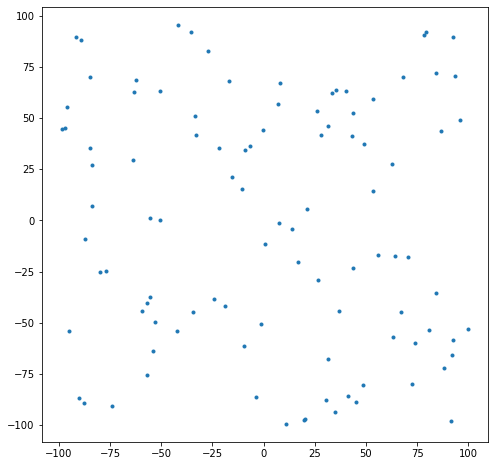

In [5]:
prepPlot()
plt.plot(*generateSetA())

## 2.b

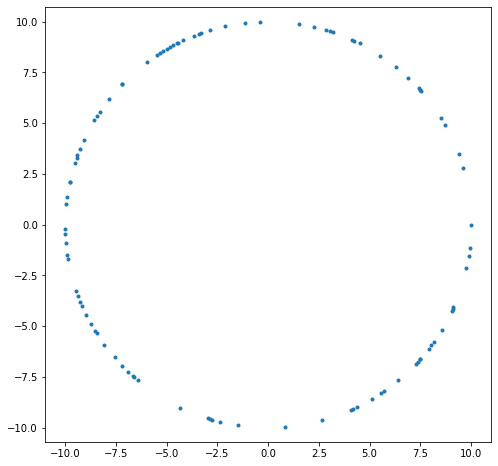

In [6]:
prepPlot()
plt.plot(*generateSetB())

## 2.c

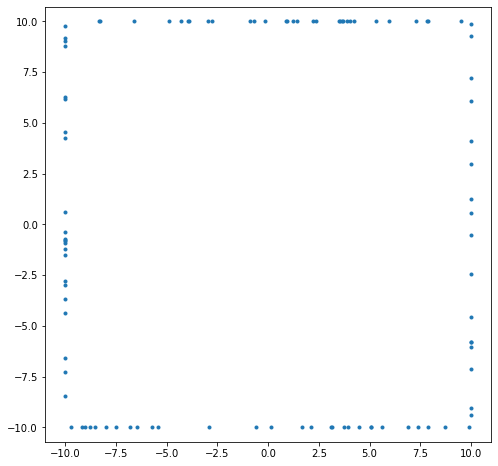

In [7]:
prepPlot()
plt.plot(*generateSetC())

## 2.d

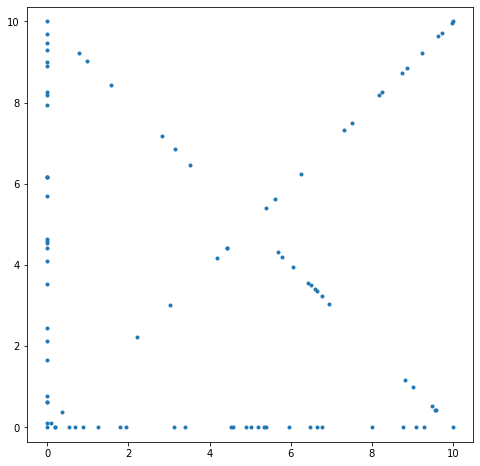

In [8]:
prepPlot()
plt.plot(*generateSetD())

# Funkcje pomocnicze

In [9]:
def signum(x):
    if x < 0:
        return -1
    elif x == 0:
        return 0
    else:
        return 1

def higherOnRightCmp(p1, p2):
    return signum(p2[1] - p1[1] if p1[1] != p2[1] else p2[0] - p1[0])

def detOwn3(p0, p1, p2):
    return p0[0] * p1[1] + p1[0] * p2[1] + p2[0] * p0[1] - p2[0] * p1[1] - p1[0] * p0[1] - p0[0] * p2[1]

def minIdxForCmp(src, cmp):
    resIdx = 0
    
    for idx in range(0, len(src)):
        if cmp(src[resIdx], src[idx]) < 0:
            resIdx = idx
            
    return resIdx

def distSqr(a, b):
    return (b[0] - a[0]) ** 2 + (b[1] - a[1]) ** 2

def farther(p0, p1, p2):
    return distSqr(p0, p2) > distSqr(p0, p1)

def distCmp(p0, p1, p2):
    return signum(distSqr(p0, p2) - distSqr(p0, p1))

def angleCmp(p0, p1, p2, epsilon):
    if p0 == p1:
        return -1
    if p0 == p2:
        return 1
    det = detOwn3(p0, p1, p2)
    return signum(det) if abs(det) > epsilon else 0

# Algorytm Jarvisa

In [10]:
def jarvis(x, y, epsilon):
    x = x.copy()
    y = y.copy()
    
    points = list(zip(x, y))
    
    if len(points) < 4:
        resX, resY = map(np.array, zip(*points))
        return resX, resY
    
    lowestLeftmostIdx = minIdxForCmp(points, higherOnRightCmp)
    result = [points[lowestLeftmostIdx]]
    skipIdx = lowestLeftmostIdx
    
    iterations = 0
    while True:
        candIdx = 1 if skipIdx == 0 else 0
        
        for idx in range(0, len(points)):
            if idx != skipIdx:
                det = detOwn3(result[-1], points[candIdx], points[idx])
                if det < -epsilon or (abs(det) <= epsilon and farther(result[-1], points[candIdx], points[idx])):
                    candIdx = idx
                    
        skipIdx = candIdx
        result.append(points[candIdx])
        if result[0] == result[-1]:
            result.pop()
            break
        
        if iterations > len(points) + 2:
            raise Exception("looped! adjust epsilon")
            
    resX, resY = map(np.array, zip(*result))
    return resX, resY

def jarvisAnimated(x, y, epsilon, ax):
    x = x.copy()
    y = y.copy()
    
    points = list(zip(x, y))
    
    if len(points) < 4:
        frame = []
        
        frame.extend([*ax.plot(x, y, 'r.')])
        
        points.append(points[0])
        frame.extend([*ax.plot(*map(np.array, zip(*points)), 'g-')])
        
        return [frame]
    
    frames = []
    
    lowestLeftmostIdx = minIdxForCmp(points, higherOnRightCmp)
    result = [points[lowestLeftmostIdx]]
    skipIdx = lowestLeftmostIdx
    
    def plotResultHull():
        return [*ax.plot(*map(np.array, zip(*result)), 'g-', linewidth=3)]
    
    def plotPoints():
        return [*ax.plot(x, y, 'k.')]
    
    def plotResult():
        return [*ax.plot(*map(np.array, zip(*result)), 'go', markersize=7)]
    
    startFrame = [*plotPoints(), *plotResult()]
    frames.append(startFrame)
    
    iterations = 0
    while True:
        candIdx = 1 if skipIdx == 0 else 0
        frames.append([*plotResultHull(), *plotPoints(), *plotResult(), *ax.plot(*points[candIdx], 'bo', markersize=7)])
        
        for idx in range(0, len(points)):
            if idx != skipIdx:
                frames.append([*plotResultHull(), *ax.plot(*map(np.array, zip(*[result[-1], points[idx]])), 'r-', linewidth=1), *plotPoints(), *plotResult(), *ax.plot(*points[candIdx], 'bo', markersize=7)])
                det = detOwn3(result[-1], points[candIdx], points[idx])
                if det < -epsilon or (abs(det) <= epsilon and farther(result[-1], points[candIdx], points[idx])):
                    candIdx = idx
                    
        skipIdx = candIdx
        result.append(points[candIdx])
        frames.append([*plotResultHull(), *plotPoints(), *plotResult()])
        if result[0] == result[-1]:
            result.pop()
            break
        
        if iterations > len(points) + 2:
            raise Exception("looped! adjust epsilon")
            
    return frames

# Algorytm Grahama

In [11]:
def graham(x, y, epsilon):
    x = x.copy()
    y = y.copy()
    
    points = list(zip(x, y))
    
    if len(points) < 4:
        resX, resY = map(np.array, zip(*points))
        return resX, resY
    
    lowestLeftmostIdx = minIdxForCmp(points, higherOnRightCmp)
    lowestLeftmostPoint = points[lowestLeftmostIdx]
    points.sort(key = lambda point: distSqr(lowestLeftmostPoint, point))
    points.sort(key = ft.cmp_to_key(lambda p1, p2: angleCmp(lowestLeftmostPoint, p1, p2, epsilon)))
    
    result = []
    
    for point in points:
        while len(result) >= 2 and angleCmp(result[-2], result[-1], point, epsilon) > 0:
            result.pop()
        result.append(point)
            
    resX, resY = map(np.array, zip(*result))
    return resX, resY

def grahamAnimated(x, y, epsilon, ax):
    x = x.copy()
    y = y.copy()
    
    points = list(zip(x, y))
    
    if len(points) < 4:
        frame = []
        
        frame.extend([*ax.plot(x, y, 'r.')])
        
        points.append(points[0])
        frame.extend([*ax.plot(*map(np.array, zip(*points)), 'g-')])
        
        return [frame]
    
    frames = []
    result = []
    
    lowestLeftmostIdx = minIdxForCmp(points, higherOnRightCmp)
    lowestLeftmostPoint = points[lowestLeftmostIdx]
    points.sort(key = lambda point: distSqr(lowestLeftmostPoint, point))
    points.sort(key = ft.cmp_to_key(lambda p1, p2: angleCmp(lowestLeftmostPoint, p1, p2, epsilon)))
    
    def plotResultHull():
        return [*ax.plot(*map(np.array, zip(*result)), 'g-', linewidth=3)]
    
    def plotPoints():
        return [*ax.plot(x, y, 'k.')]
    
    def plotResult():
        return [*ax.plot(*map(np.array, zip(*result)), 'go', markersize=7)]
    
    for point in points:
        while len(result) >= 2 and angleCmp(result[-2], result[-1], point, epsilon) > 0:
            result.append(point)
            frames.append([*plotResultHull(), *plotPoints(), *plotResult()])
            frames.append([*plotResultHull(), *ax.plot(*map(np.array, zip(*[result[-3], point])), 'r-', linewidth=1), *plotPoints(), *plotResult()])
            result.pop()
            result.pop()
            
        result.append(point)
        frames.append([*plotResultHull(), *plotPoints(), *plotResult()])
    
    result.append(result[0])
    frames.append([*plotResultHull(), *plotPoints(), *plotResult()])
        
    return frames

# Test czasu działania algorytmów

In [12]:
EPSILON = 10 ** -13

for idx, pointsSrc in enumerate([lambda x: generateSetA(x), 
                                 lambda x: generateSetB(x), 
                                 lambda x: generateSetC(x), 
                                 lambda x: generateSetD(x // 4, x // 4, x // 4, x // 4)]):
    for setsize in range(1000, 11000, 1000):
        x, y = pointsSrc(setsize)
        tm.getDelta()
        xHull, yHull = jarvis(x, y, EPSILON)
        a = tm.getDelta()
        xHull, yHull = graham(x, y, EPSILON)
        b = tm.getDelta()
        print(f"{idx},{setsize},{a},{b}")

0,1000,0.06856152600000032,0.04157307699999979
0,2000,0.1082838530000001,0.08722422899999982
0,3000,0.18750835000000032,0.13453736999999988
0,4000,0.24815976299999987,0.18988377600000028
0,5000,0.32853587799999984,0.23978660600000046
0,6000,0.38294475699999975,0.2903566209999999
0,7000,0.4523556759999998,0.3537077169999998
0,8000,0.5351476279999998,0.41519646199999993
0,9000,0.46382641699999994,0.4669995490000005
0,10000,0.8110961310000002,0.5247245429999996
1,1000,2.7291454349999995,0.02552621999999971
1,2000,11.713459738000001,0.05375036099999875
1,3000,26.288552558,0.07954617400000075
1,4000,46.169965111,0.10572180699999478
1,5000,71.23196019499998,0.1289566000000093
1,6000,102.868945433,0.157342615999994
1,7000,141.46369976300002,0.19041566900000362
1,8000,188.13046539200002,0.22183031700001266
1,9000,239.04566546800004,0.2631849519999605
1,10000,312.261572816,0.2849189930000193
2,1000,0.030364158000111274,0.029048917999944024
2,2000,0.06112668799983112,0.05827146900014668
2,3000,0

# Zbiór testowy A

In [13]:
x, y = generateSetA(50)
saveToCsv(x, y, "set_a_source.csv")

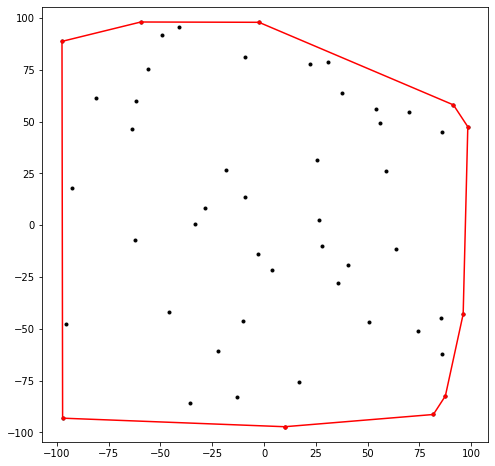

In [14]:
xHull, yHull = jarvis(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_a_jarvis.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

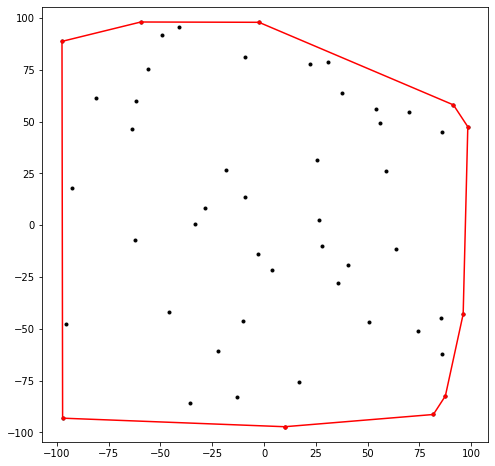

In [15]:
xHull, yHull = graham(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_a_graham.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

In [16]:
%%capture
prepPlot()
fig, ax = plt.subplots()
ani = anim.ArtistAnimation(fig, jarvisAnimated(x, y, 10 ** -13, ax), interval=50)

In [17]:
ani

In [18]:
%%capture
prepPlot()
fig, ax = plt.subplots()
ani = anim.ArtistAnimation(fig, grahamAnimated(x, y, 10 ** -13, ax), interval=50)

In [19]:
ani

# Zbiór testowy B (bez animacji dla Jarvisa)

In [20]:
x, y = generateSetB()
saveToCsv(x, y, "set_b_source.csv")

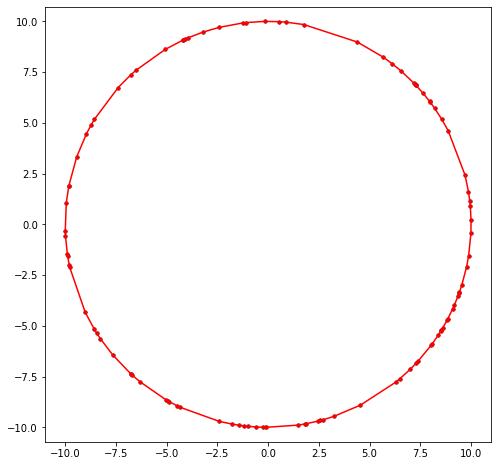

In [21]:
xHull, yHull = jarvis(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_b_jarvis.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

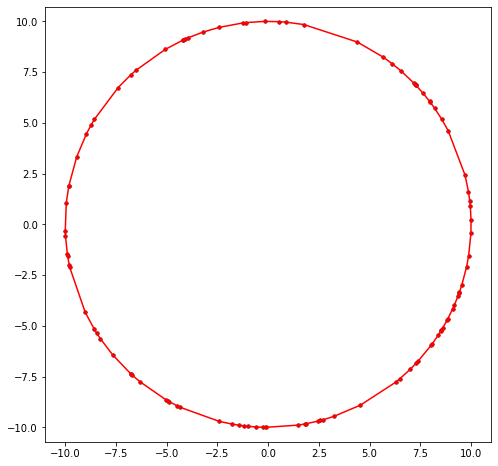

In [22]:
xHull, yHull = graham(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_b_graham.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

In [23]:
%%capture
prepPlot()
fig, ax = plt.subplots()
ani = anim.ArtistAnimation(fig, grahamAnimated(x, y, 10 ** -13, ax), interval=50)

In [24]:
ani

# Zbiór testowy C (zmodyfikowany)

In [25]:
x, y = generateSetC(50, -10, -2, 10, 2)
saveToCsv(x, y, "set_c_mod_source.csv")

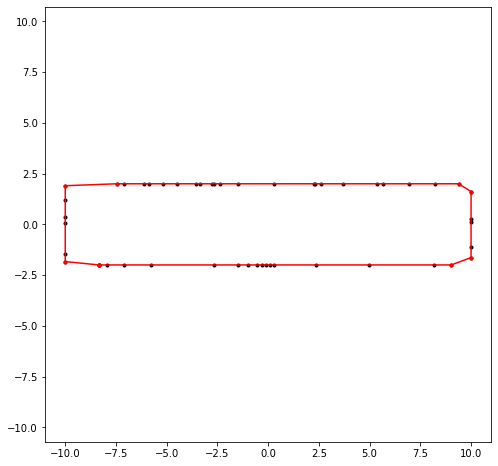

In [26]:
xHull, yHull = jarvis(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_c_mod_jarvis.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

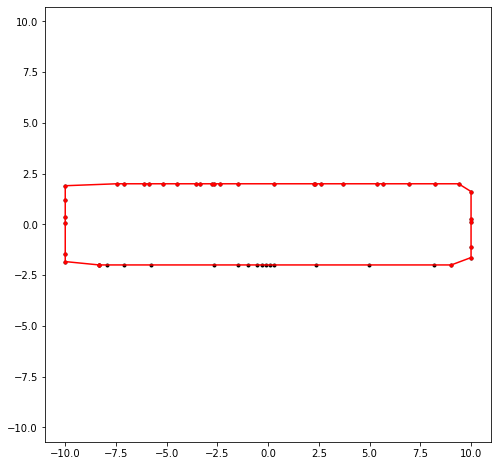

In [27]:
xHull, yHull = graham(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_c_mod_graham.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

In [28]:
%%capture
prepPlot()
fig, ax = plt.subplots()
ani = anim.ArtistAnimation(fig, jarvisAnimated(x, y, 10 ** -13, ax), interval=50)

In [29]:
ani

In [30]:
%%capture
prepPlot()
fig, ax = plt.subplots()
ani = anim.ArtistAnimation(fig, grahamAnimated(x, y, 10 ** -13, ax), interval=50)

In [31]:
ani

# Zbiór testowy D

In [32]:
x, y = generateSetD()
saveToCsv(x, y, "set_d_source.csv")

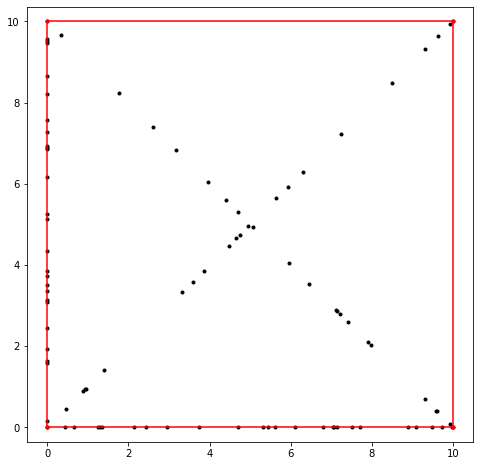

In [33]:
xHull, yHull = jarvis(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_d_jarvis.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

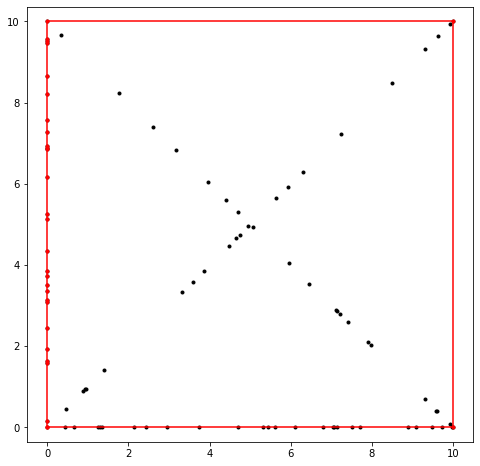

In [34]:
xHull, yHull = graham(x, y, 10 ** -13)
saveToCsv(xHull, yHull, "set_d_graham.csv")
xHull = np.append(xHull, xHull[0])
yHull = np.append(yHull, yHull[0])
prepPlot()
plt.plot(x, y, 'k')
plt.plot(xHull, yHull, 'r-')
plt.plot(xHull, yHull, 'r.')

In [35]:
%%capture
prepPlot()
fig, ax = plt.subplots()
ani = anim.ArtistAnimation(fig, jarvisAnimated(x, y, 10 ** -13, ax), interval=50)

In [36]:
ani

In [37]:
%%capture
prepPlot()
fig, ax = plt.subplots()
ani = anim.ArtistAnimation(fig, grahamAnimated(x, y, 10 ** -13, ax), interval=50)

In [38]:
ani